# Cellphone Price Range Prediction

- PTID-CDS-JAN-24-1759
- PRCP-1000 - Portugese bank
- Project by Sushanth KS
- sushanthkudrethaya20@gmail.com

## 1) Business case / Problem Statement

- Bob has started his own mobile company. He wants to give a tough fight to big companies like
  Apple, Samsung etc.

- He does not know how to estimate the price of mobiles his company creates. In this competitive
  mobile phone market, you cannot simply assume things. To solve this problem he collects sales data of mobile phones 
  of various companies.
- Bob wants to find out some relation between features of a mobile phone(eg:- RAM, Internal Memory
  etc) and its selling price. But he is not so good at Machine Learning. So he needs your help to solve
  this problem. 
- In this problem you do not have to predict the actual price but a price range indicating how high the
  price is.

### Goal

- Task 1:- Prepare a complete data analysis report on the given data.
- Task 2:- On the basis of the mobile Specification like Battery power, 3G enabled ,
           wifi ,Bluetooth, Ram etc predict the Price range of the mobile.
- Task 3:- Prepare the analysis report stating how model will help expanding the
           business by stating several factors including feature importance.

## 2) Importing the libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings as war
war.filterwarnings('ignore')

## 3) Loading the data

In [3]:
mdata = pd.read_csv('Cellphone_price_range.csv')

In [4]:
# for displaying all the rows and columns

pd.set_option('display.max_rows',None) # none means unlimited
pd.set_option('display.max_columns',None)

## 4) Domain Analysis

## 5) Basic Checks

In [5]:
# first five rows of the dataset

mdata.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1


In [6]:
# last five rows of the dataset

mdata.tail()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
1995,794,1,0.5,1,0,1,2,0.8,106,6,14,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,3,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,3,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,5,336,670,869,18,10,19,1,1,1,0
1999,510,1,2.0,1,5,1,45,0.9,168,6,16,483,754,3919,19,4,2,1,1,1,3


In [7]:
# checking for the shape of the columns

mdata.shape

print('Total rows:',mdata.shape[0])
print('Total columns:',mdata.shape[1])

Total rows: 2000
Total columns: 21


In [8]:
# checking for the basic info of the table

mdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

#### Notes:

- No null values
- Two float values, the rest are int and no objects in the dataset
- price_range is our target feature

In [9]:
# double checking if there any null values

mdata.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [10]:
# checking the statistical data

mdata.describe().T

,count,mean,std,min,25%,50%,75%,max
battery_power,2000.0,1238.51850,439.418206,501.0,851.75,1226.0,1615.25,1998.0
blue,2000.0,0.49500,0.500100,0.0,0.00,0.0,1.00,1.0
clock_speed,2000.0,1.52225,0.816004,0.5,0.70,1.5,2.20,3.0
dual_sim,2000.0,0.50950,0.500035,0.0,0.00,1.0,1.00,1.0
fc,2000.0,4.30950,4.341444,0.0,1.00,3.0,7.00,19.0
four_g,2000.0,0.52150,0.499662,0.0,0.00,1.0,1.00,1.0
int_memory,2000.0,32.04650,18.145715,2.0,16.00,32.0,48.00,64.0
m_dep,2000.0,0.50175,0.288416,0.1,0.20,0.5,0.80,1.0
mobile_wt,2000.0,140.24900,35.399655,80.0,109.00,141.0,170.00,200.0
n_cores,2000.0,4.52050,2.287837,1.0,3.00,4.0,7.00,8.0


- We confirm that there are no columns/features where every value is the same or constant as there are no columns with std=0

- minimum value of px_height and sc_w cannot be zero so we need to handle that

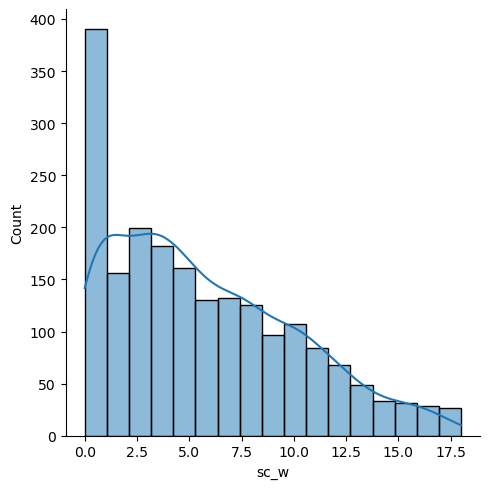

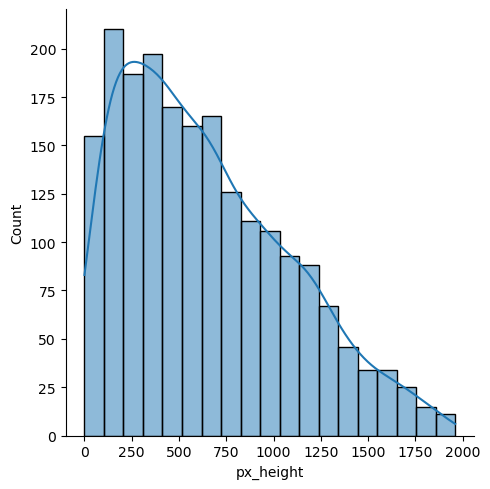

In [11]:
# checking distribution before replacing
# as the distribution is skewed we replace it with median if we have to replace
print(sns.displot(x=mdata.sc_w,kde=True))
print(sns.displot(x=mdata.px_height,kde=True))

In [71]:
# checking for the number of such zero entries in px_height and sc_w 

print('Total number of phones with Screen width zero:', len(mdata[mdata.sc_w==0]))
print('Total number of phones with pixel height zero:', len(mdata[mdata.px_height==0]))

Total number of phones with Screen width zero: 180
Total number of phones with pixel height zero: 2


In [72]:
# so we find the index of such rows first 

print('index positions of pixel height width zero', mdata.px_height[mdata.px_height == 0].index,'\n')  
print('index positions of Screen width zero','\n',mdata.sc_w[mdata[mdata.sc_w == 0].index]) 

index positions of pixel height width zero Int64Index([1481, 1933], dtype='int64') 

index positions of Screen width zero 
 12      0
24      0
33      0
42      0
50      0
54      0
62      0
73      0
86      0
119     0
128     0
131     0
140     0
141     0
144     0
157     0
158     0
159     0
186     0
207     0
210     0
238     0
249     0
257     0
263     0
264     0
285     0
295     0
311     0
312     0
320     0
326     0
332     0
333     0
342     0
346     0
347     0
354     0
364     0
390     0
398     0
401     0
406     0
435     0
440     0
476     0
489     0
490     0
495     0
521     0
537     0
572     0
623     0
626     0
637     0
640     0
641     0
643     0
646     0
655     0
679     0
700     0
718     0
734     0
741     0
744     0
776     0
778     0
780     0
783     0
805     0
806     0
828     0
832     0
840     0
844     0
854     0
874     0
875     0
893     0
899     0
900     0
945     0
962     0
970     0
971     0
1003    0
1009  

In [73]:
# replacing the zero values with the median so that it won't affect the dataset much
# we can do this in a single step as well like below

mdata.px_height[mdata[mdata.px_height == 0].index] = mdata.px_height.median()
mdata.sc_w[mdata[mdata.sc_w == 0].index] = mdata.sc_w.median()


In [74]:
# checking for such entries with zeros
# so its handled now

print('Total number of phones with Screen width zero:', len(mdata[mdata.sc_w==0]))
print('Total number of phones with pixel height zero:', len(mdata[mdata.px_height==0]))

Total number of phones with Screen width zero: 0
Total number of phones with pixel height zero: 0


In [15]:
# checking for duplicated data

mdata.duplicated().sum()

# no duplicate values which makes this dataset very good

0

## 6) Exploratory Data Analysis (EDA)

### Univariate Analysis

                                             |                                             | [  0%]   00:00 ->…


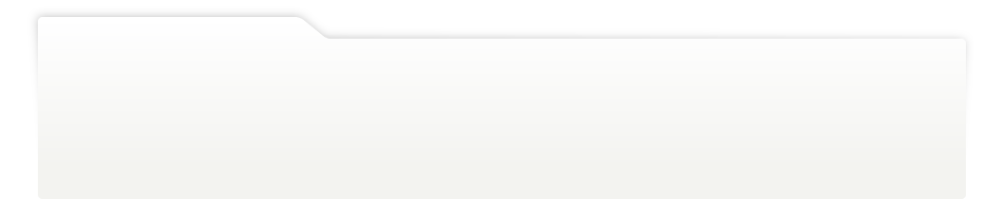
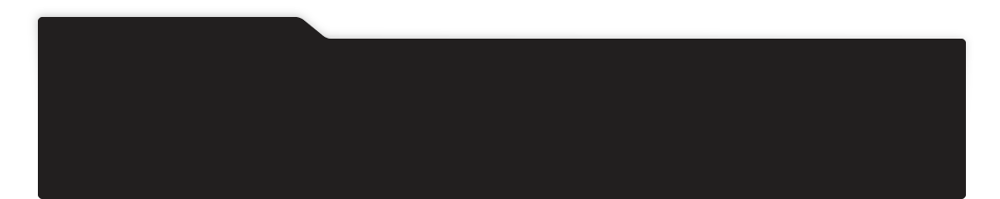
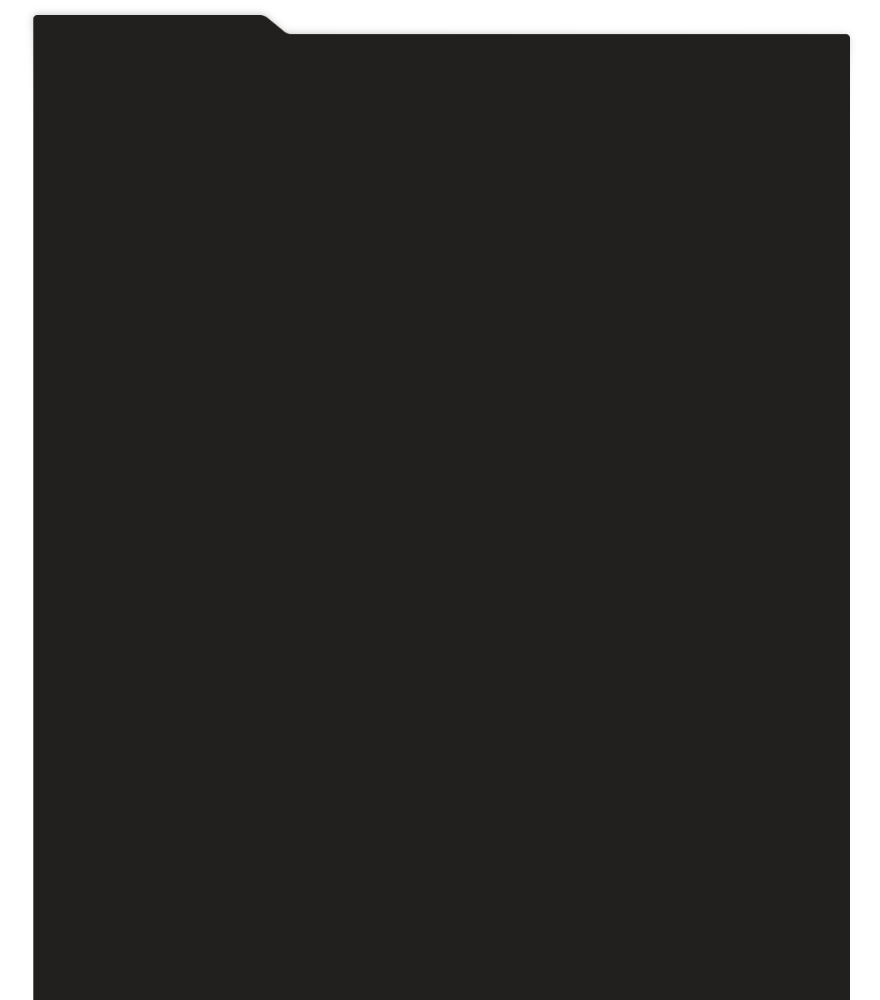
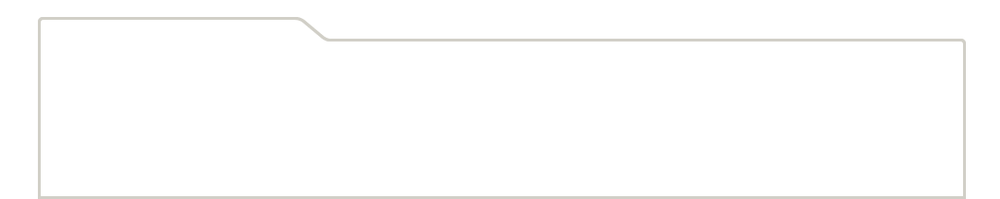
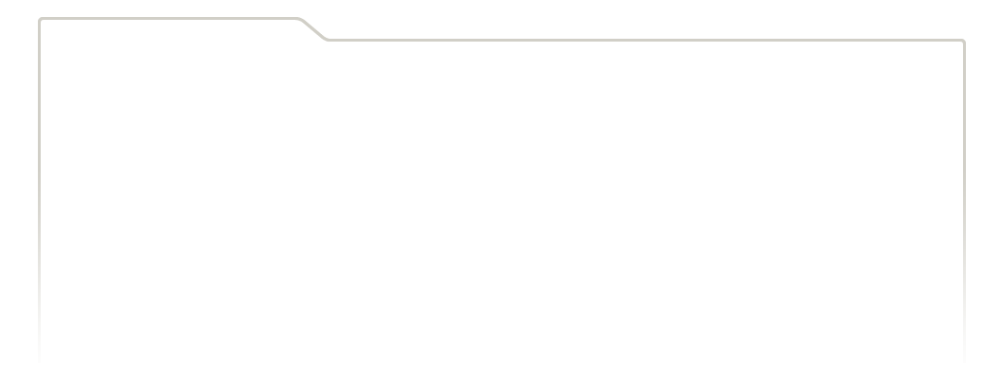
...
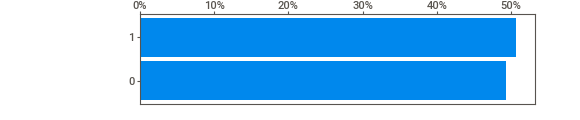
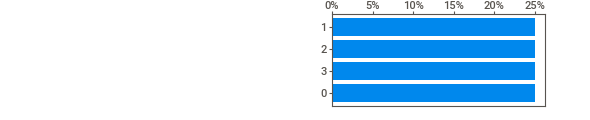
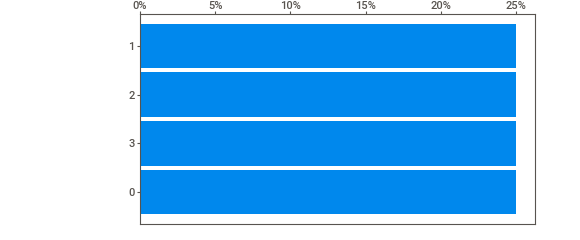
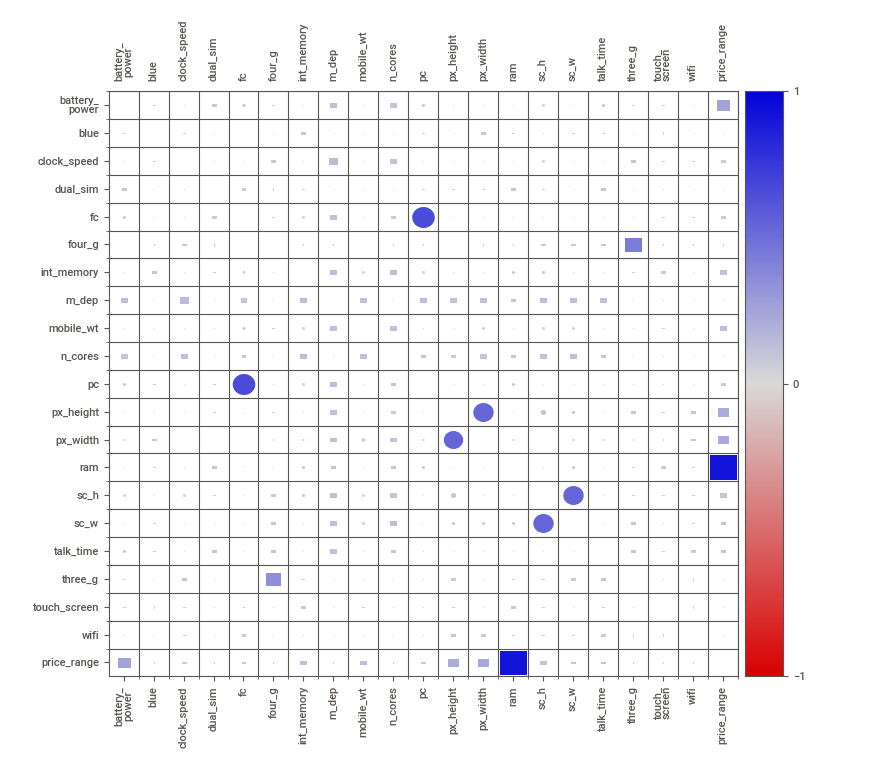
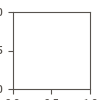

In [17]:
import sweetviz as sv
my_report = sv.analyze(mdata)
my_report.show_notebook()

#### Insights from the univariate analysis

- the battery_power ranges from 501 to 1998 mAh/unit
- the clock_speed ranges from 0.5 to 3
- 23.7% of the phones don't have a front camera and max number of pixels in the front cameras in a phone is 19
- the internal memory ranges from 2 to 64 GB/units
- mobile weight ranges from 80 to 200 units
- number of cores in the processor ranges from 1 to 8
- 5% of the phones don't have a primary camera and max number of pixels in the primary cameras in a phone is 20
- ram ranges from 256 to 3998

- Percentage Distribution of Mobiles both having and not having bluetooth,dual sim, 4G, wifi and touchscreen are almost 50 %.
- 1 means it has the specifications.
- 0 means it do not have the specifications.

- price range is the target feature and is evenly balanced


### Bivariate Analysis

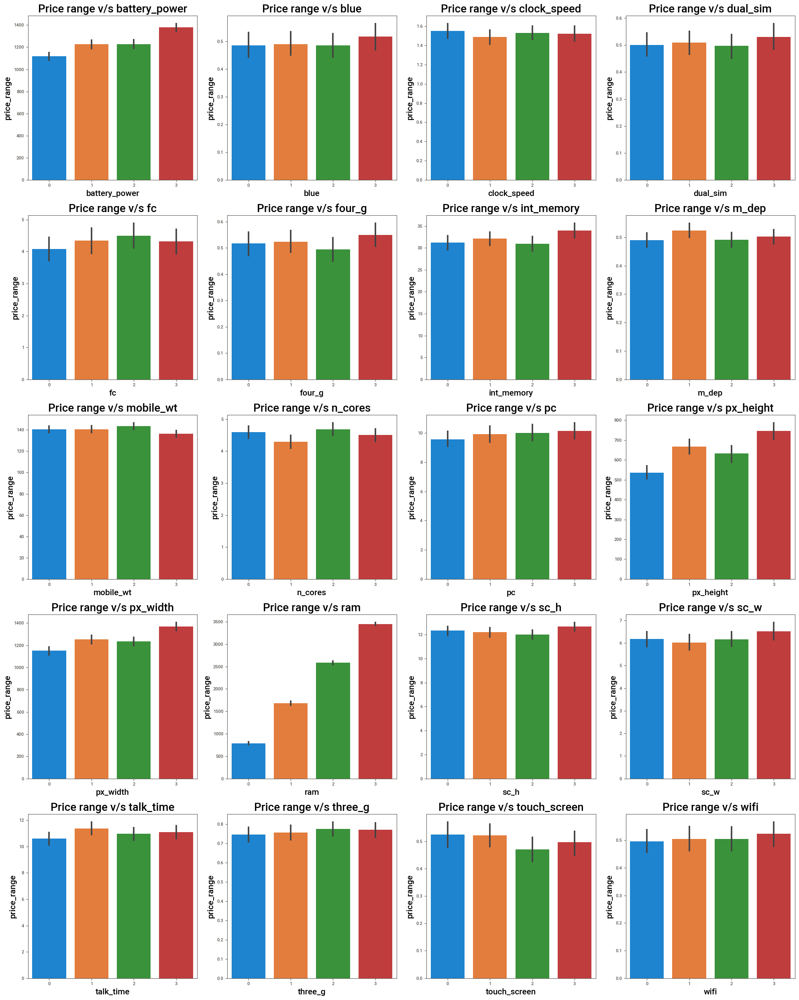

In [18]:
# Checking relationship of major features with respect to target variable 

plt.figure(figsize=(20,25),facecolor='white')
i = 1


for col in mdata:
    if i<=20:
        ax = plt.subplot(5,4,i)
        sns.barplot(x=mdata.price_range,y= mdata[col])
        plt.title(f'Price range v/s {col}',fontsize=20)
        plt.xlabel(col,fontsize=15)
        plt.ylabel('price_range',fontsize=15)
    i+=1
plt.tight_layout()

#### Insights from the Bivariate analysis

###### As RAM increases price range also increases
* Mobiles having RAM more than 3000MB falls under Very high cost category (3)
* Mobiles having RAM less than 1000 MB falls under low cost category (0)

##### As battery_power increses the price range also increases
* Mobiles with battery power more than 1300 mAh has very high cost. 
* Mobiles with battery power between 1200 and 1300 mAH falls under medium and high cost category.

#### Pixel height and pixel width has slight correlation with the price range
*Mobiles with more than 700 pixel height and width more than 1300 has very high cost.*

### The rest of the features has either little or no affect on the target(price_range)


### Multivariate Analysis

In [19]:
# not relevant here as there are more than 20 columns/features

## 7) Data Processing

In [68]:
# no missing values
# no duplicates
# so check for outliers

<Axes: >

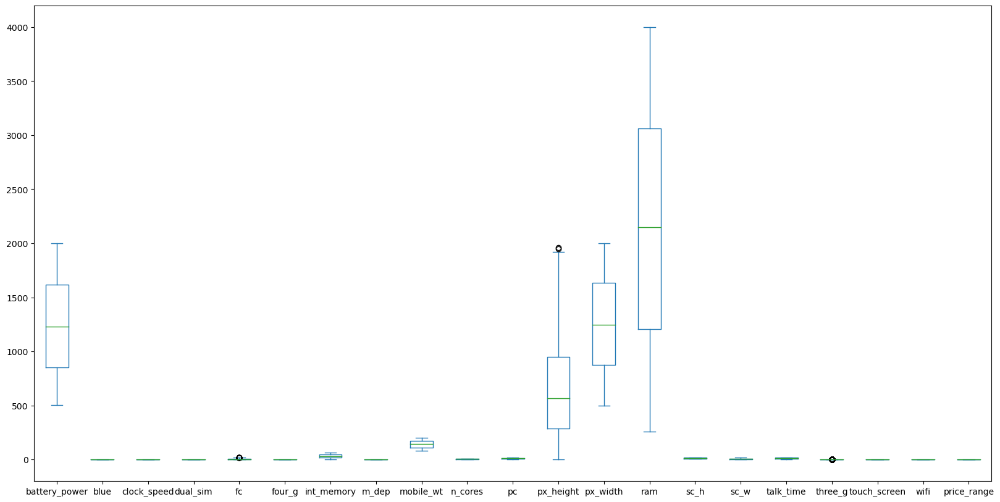

In [16]:
mdata.plot(kind='box',figsize=(20,10))

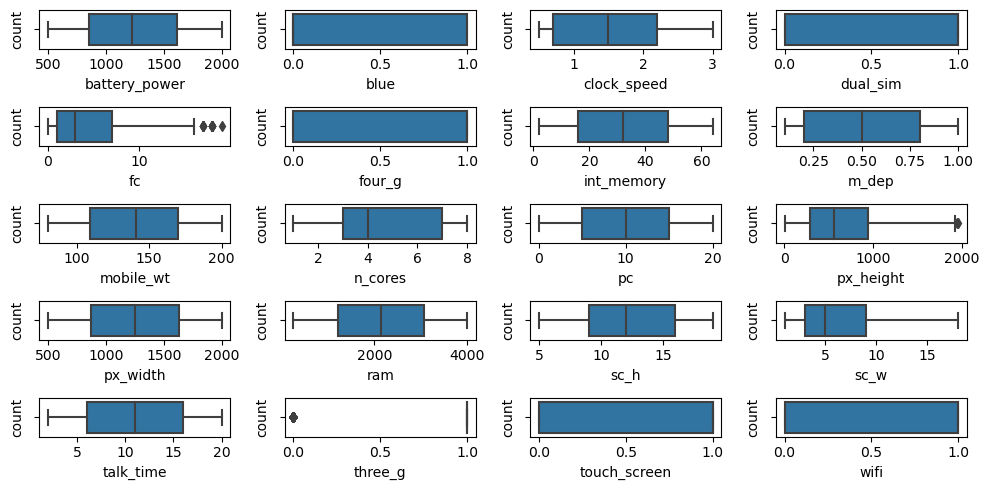

In [17]:
plt.figure(figsize=(10,5),facecolor='white')

i=1
for col in mdata.drop('price_range',axis=1):     # we dont find the outlier for the target
    if i <= 20:
        bx = plt.subplot(5,4,i)
        sns.boxplot(x=mdata[col])                 # similarly we can use violinplot for find the distribution
        plt.xlabel(col,fontsize=10)              # gen nto required
        plt.ylabel('count',fontsize=10)
    i+=1
plt.tight_layout()

#### fc and px_height has some outliers.

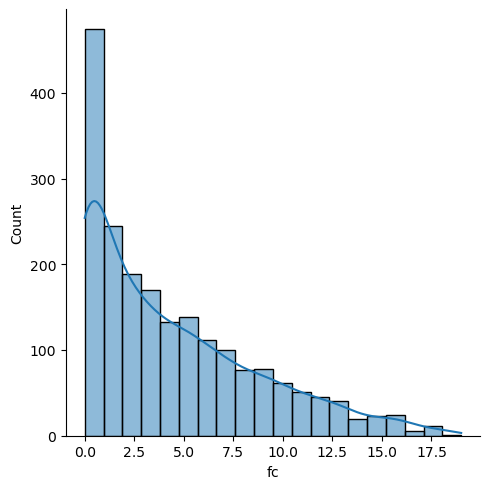

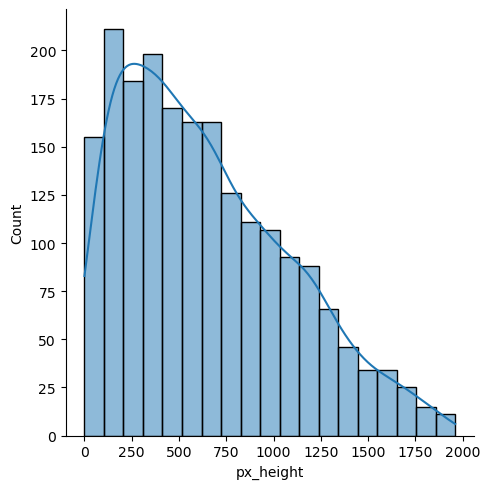

In [75]:
# checking distribution before handling the outlier
# we use IQR method if the distribution is skewed
# we use 3-Sigma method if the distribution is normal

print(sns.displot(x=mdata.fc,kde=True))
print(sns.displot(x=mdata.px_height,kde=True))



In [76]:
# both fc and px_height are not having a normal distribution 
# Hence, we will go with the IQR method here to handle the outliers

### Handling the outliers

##### Handling for fc feature

In [77]:
# Handling the outlier in fc column using IQR method
# find Q1 and Q3

Q1 = mdata.fc.quantile(0.25)
print('Lower quartile =',Q1)
Q3 = mdata.fc.quantile(0.75)
print('Upper quartile =',Q3)

# find IQR
IQR = Q3-Q1
print('IQR=',IQR)

Lower quartile = 1.0
Upper quartile = 7.0
IQR= 6.0


In [78]:
# find lower and upper limit

lower_limit = Q1 - (1.5*IQR)
print('The lower limit=',lower_limit)
upper_limit = Q3 + (1.5*IQR)
print('The upper limit=',upper_limit)

The lower limit= -8.0
The upper limit= 16.0


In [79]:
# find records/values which are > the upper limit 
mdata.loc[(mdata.fc>upper_limit)]

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
95,1137,1,1.0,0,18,0,7,1.0,196,3,19,942,1179,3616,13,5,12,1,1,1,3
169,1569,0,2.8,1,17,0,44,0.3,110,4,20,45,1942,1260,9,2,17,1,0,0,1
226,1708,1,2.4,1,18,1,49,0.1,109,1,19,233,517,3388,6,4,16,1,1,1,3
229,1689,0,1.8,0,17,0,24,0.3,127,3,18,954,1200,2766,7,2,7,0,1,1,3
300,1937,1,1.7,0,17,0,58,0.6,189,1,19,1728,1767,3321,5,4,14,1,1,0,3
305,1348,0,2.0,0,18,0,52,0.3,98,3,20,1869,1942,955,18,11,7,1,1,1,1
372,1703,1,1.5,1,17,1,55,0.7,138,5,19,1411,1711,2993,5,1,20,1,1,1,3
584,946,1,2.6,1,17,0,5,0.1,166,3,20,1698,1771,3720,15,7,4,0,1,0,3
1387,1533,1,1.1,1,18,1,17,0.3,160,4,20,1054,1393,2520,8,2,11,1,0,1,2
1406,1731,1,2.3,1,18,0,60,0.5,171,4,20,142,1039,1220,9,3,20,0,1,0,1


In [80]:
# finding the lower limit
# nothing below the lower limit

mdata.loc[mdata.fc<lower_limit]

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range


In [81]:
# we have to make sure that the outlier percentage is < 5% 
len(mdata.loc[mdata.fc>upper_limit])/len(mdata)

# as we can see here its less than 5% of the data

0.009

In [82]:
# replacing with median
mdata.loc[mdata.fc>upper_limit,'fc'] = mdata.fc.median()

##### Handling outlier for px_height feature

In [83]:
# Handling the outlier in fc column using IQR method
# find Q1 and Q3

Q1 = mdata.px_height.quantile(0.25)
print('Lower quartile =',Q1)
Q3 = mdata.px_height.quantile(0.75)
print('Upper quartile =',Q3)

# find IQR
IQR = Q3-Q1
print('IQR=',IQR)

Lower quartile = 284.0
Upper quartile = 947.25
IQR= 663.25


In [84]:
# find lower and upper limit

lower_limit = Q1 - (1.5*IQR)
print('The lower limit=',lower_limit)
upper_limit = Q3 + (1.5*IQR)
print('The upper limit=',upper_limit)

The lower limit= -710.875
The upper limit= 1942.125


In [85]:
# find records/values which are > the upper limit 

mdata.loc[(mdata.px_height>upper_limit)]

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
988,1413,1,0.5,1,4,1,45,0.4,104,5,6,1949,1994,2973,17,8,15,1,0,1,3
1771,1230,1,1.6,0,0,1,48,0.7,111,7,2,1960,1963,1622,18,17,16,1,1,1,2


In [86]:
# finding the lower limit
# nothing below the lower limit

mdata.loc[mdata.px_height<lower_limit]

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range


In [87]:
# we have to make sure that the outlier percentage is < 5% 
len(mdata.loc[mdata.px_height>upper_limit])/len(mdata)

# its less than 5%

0.001

In [88]:
# replacing with median
mdata.loc[mdata.px_height>upper_limit,'px_height'] = mdata.px_height.median()

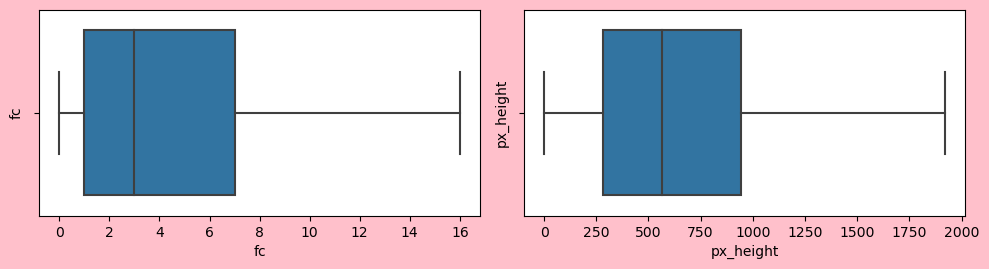

In [89]:
# confirming that there are no outliers left

plt.figure(figsize=(10,5),facecolor='pink')

i = 1
features = ['fc','px_height']

for col in features:
    if i<=2:
        ax = plt.subplot(2,2,i)
        sns.boxplot(x=mdata[col])
        plt.xlabel(col,fontsize=10)
        plt.ylabel(col,fontsize=10)
    i+=1
plt.tight_layout()

#### Outliers are now handled

## 7.a) Scaling

In [90]:
mdata.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1


In [91]:
mdata.columns

Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi', 'price_range'],
      dtype='object')

In [92]:
from sklearn.preprocessing import StandardScaler
scaling =StandardScaler()
mdata[['battery_power', 'clock_speed','fc','int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time']] = scaling.fit_transform(mdata[['battery_power', 'clock_speed','fc','int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time']])

In [93]:
mdata.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,-0.902597,0,0.830779,0,-0.765716,0,-1.380644,0.340740,1.349249,-1.101971,-1.305750,-1.414718,-1.146784,0.391703,-0.784983,0.196824,1.462493,0,0,1,1
1,-0.495139,1,-1.253064,1,-1.006735,1,1.155024,0.687548,-0.120059,-0.664768,-0.645989,0.590828,1.704465,0.467317,1.114266,-0.808661,-0.734267,1,1,0,2
2,-1.537686,1,-1.253064,1,-0.524698,1,0.493546,1.381165,0.134244,0.209639,-0.645989,1.402112,1.074968,0.441498,-0.310171,-1.060033,-0.368140,1,1,0,2
3,-1.419319,1,1.198517,0,-1.006735,0,-1.215274,1.034357,-0.261339,0.646842,-0.151168,1.295602,1.236971,0.594569,0.876859,0.448195,-0.002014,1,0,0,2
4,1.325906,1,-0.395011,0,2.126507,1,0.658915,0.340740,0.021220,-1.101971,0.673534,1.277473,-0.091452,-0.657666,-1.022389,-1.060033,0.730240,1,1,0,1


#### Note:
Except for 0/1 type of features we scaled down all the other features with continuous numerical values to between [0,1] using the MinMaxScalar() or Normalization so that model will be able to work effciently with the data

## 7.a) Encoding

-- Not required here as there are no categorical features

## 8) Feature Engineering

<Axes: >

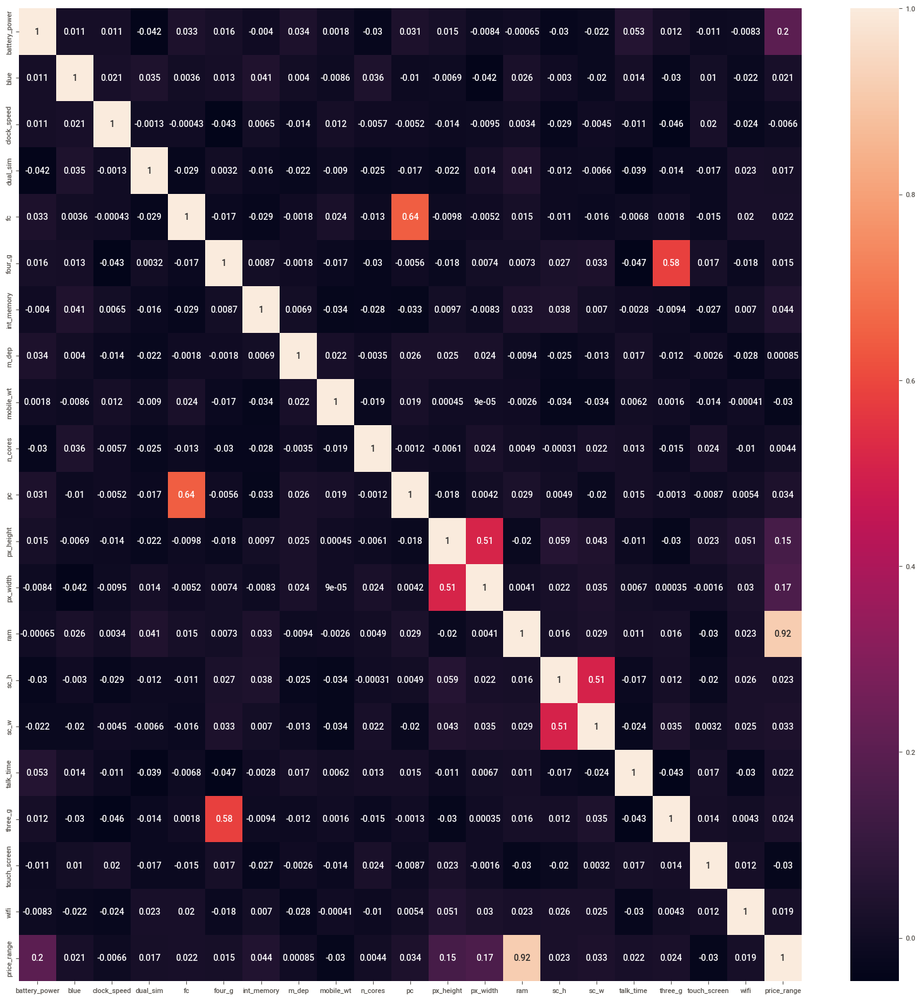

In [209]:
plt.figure(figsize=(20,20))
sns.heatmap(data=mdata.corr(),annot=True)

# no features to drop here

###### - RAM and price_range shows high correlation which is a good sign, it signifies that RAM will play major deciding factor in estimating the price range.

###### - There is some collinearity in feature pairs ('pc', 'fc') and ('px_width', 'px_height'). Both correlations are justified since there are good chances that if front camera of a phone is good, the back camera would also be good.

###### - Also, if px_height increases, pixel width also increases, that means the overall pixels in the screen. 

## 9) Split the data

In [94]:
X = mdata.drop('price_range',axis=1)
y = mdata.price_range

## 10) train-test split

In [95]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=15,stratify=y)

## 11) Balancing data

In [96]:
mdata.price_range.value_counts()

# not required here as the data looks balanced

1    500
2    500
3    500
0    500
Name: price_range, dtype: int64

## 12) Model Building

### 1) Logistic Regression

In [157]:
from sklearn.linear_model import LogisticRegression
model_LogR = LogisticRegression()
model_LogR.fit(X_train,y_train)

LogisticRegression()

In [158]:
y_pred_LogR = model_LogR.predict(X_test)

In [159]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
acc_LogR = accuracy_score(y_test,y_pred_LogR)
print('The model accuracy score is:', acc_LogR)
print('The confusion matrix of the model:','\n',confusion_matrix(y_test,y_pred_LogR))

The model accuracy score is: 0.9575
The confusion matrix of the model: 
 [[98  2  0  0]
 [ 2 97  1  0]
 [ 0  6 91  3]
 [ 0  0  3 97]]


In [160]:
print(classification_report(y_test,y_pred_LogR))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       100
           1       0.92      0.97      0.95       100
           2       0.96      0.91      0.93       100
           3       0.97      0.97      0.97       100

    accuracy                           0.96       400
   macro avg       0.96      0.96      0.96       400
weighted avg       0.96      0.96      0.96       400



### 2) KNN Classifier

In [161]:
from sklearn.neighbors import KNeighborsClassifier
model_knn = KNeighborsClassifier()
model_knn.fit(X_train,y_train)

KNeighborsClassifier()

In [162]:
y_pred_knn = model_knn.predict(X_test)

In [163]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
acc_knn = accuracy_score(y_test,y_pred_knn)
print('The accuracy score is:',acc_knn,'\n')
print('The confusion matrix of the model:','\n',confusion_matrix(y_test,y_pred_knn),'\n')


The accuracy score is: 0.5875 

The confusion matrix of the model: 
 [[80 19  1  0]
 [39 42 18  1]
 [ 1 40 48 11]
 [ 0  6 29 65]] 



In [164]:
print(classification_report(y_test,y_pred_knn))

              precision    recall  f1-score   support

           0       0.67      0.80      0.73       100
           1       0.39      0.42      0.41       100
           2       0.50      0.48      0.49       100
           3       0.84      0.65      0.73       100

    accuracy                           0.59       400
   macro avg       0.60      0.59      0.59       400
weighted avg       0.60      0.59      0.59       400



### 3) Support Vector Classifier

In [1]:
from sklearn.svm import SVC
model_svc = SVC(kernel='linear',C=10)
model_svc.fit(X_train,y_train)

NameError: name 'X_train' is not defined

In [173]:
y_pred_svc = model_svc.predict(X_test)

In [174]:
from sklearn.metrics import accuracy_score,confusion_matrix
acc_svc = accuracy_score(y_pred_svc,y_test)
print('The model accuracy score is:', acc_svc)
print('The confusion matrix of the model:','\n',confusion_matrix(y_pred_svc,y_test))

The model accuracy score is: 0.9
The confusion matrix of the model: 
 [[94  6  0  0]
 [ 6 90 12  0]
 [ 0  4 84  8]
 [ 0  0  4 92]]


In [175]:
print(classification_report(y_test,y_pred_svc))

              precision    recall  f1-score   support

           0       0.94      0.94      0.94       100
           1       0.83      0.90      0.87       100
           2       0.88      0.84      0.86       100
           3       0.96      0.92      0.94       100

    accuracy                           0.90       400
   macro avg       0.90      0.90      0.90       400
weighted avg       0.90      0.90      0.90       400



### 3.a) SVC after hyperparameter tuninng

In [176]:
# parameter grid for GridSearchCv

grid_values = {
    'C':[0.01,0.1,1,10,20],
    'kernel' : ["linear","poly","rbf","sigmoid"],
    'gamma' : [0.001,0.01,1]
}

In [177]:
# creating an object for classifier
model_svc_hyp  = SVC ()


In [178]:
# Hyperparameter tuning with the GrdiSearhCV with cv=5
svc_cv = GridSearchCV(model_svc_hyp, grid_values, cv = 5,verbose=2)
svc_cv.fit(X_train,y_train)     # fitting the data into the model

Fitting 5 folds for each of 60 candidates, totalling 300 fits
[CV] END .................C=0.01, gamma=0.001, kernel=linear; total time=   0.0s
[CV] END .................C=0.01, gamma=0.001, kernel=linear; total time=   0.0s
[CV] END .................C=0.01, gamma=0.001, kernel=linear; total time=   0.0s
[CV] END .................C=0.01, gamma=0.001, kernel=linear; total time=   0.0s
[CV] END .................C=0.01, gamma=0.001, kernel=linear; total time=   0.0s
[CV] END ...................C=0.01, gamma=0.001, kernel=poly; total time=   0.0s
[CV] END ...................C=0.01, gamma=0.001, kernel=poly; total time=   0.0s
[CV] END ...................C=0.01, gamma=0.001, kernel=poly; total time=   0.0s
[CV] END ...................C=0.01, gamma=0.001, kernel=poly; total time=   0.0s
[CV] END ...................C=0.01, gamma=0.001, kernel=poly; total time=   0.0s
[CV] END ....................C=0.01, gamma=0.001, kernel=rbf; total time=   0.0s
[CV] END ....................C=0.01, gamma=0.00

[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=   0.0s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=   0.0s
[CV] END .....................C=0.1, gamma=1, kernel=sigmoid; total time=   0.0s
[CV] END ...................

[CV] END ......................C=10, gamma=0.01, kernel=poly; total time=   0.0s
[CV] END .......................C=10, gamma=0.01, kernel=rbf; total time=   0.0s
[CV] END .......................C=10, gamma=0.01, kernel=rbf; total time=   0.0s
[CV] END .......................C=10, gamma=0.01, kernel=rbf; total time=   0.0s
[CV] END .......................C=10, gamma=0.01, kernel=rbf; total time=   0.0s
[CV] END .......................C=10, gamma=0.01, kernel=rbf; total time=   0.0s
[CV] END ...................C=10, gamma=0.01, kernel=sigmoid; total time=   0.0s
[CV] END ...................C=10, gamma=0.01, kernel=sigmoid; total time=   0.0s
[CV] END ...................C=10, gamma=0.01, kernel=sigmoid; total time=   0.0s
[CV] END ...................C=10, gamma=0.01, kernel=sigmoid; total time=   0.0s
[CV] END ...................C=10, gamma=0.01, kernel=sigmoid; total time=   0.0s
[CV] END .......................C=10, gamma=1, kernel=linear; total time=   0.0s
[CV] END ...................

GridSearchCV(cv=5, estimator=SVC(),
             param_grid={'C': [0.01, 0.1, 1, 10, 20], 'gamma': [0.001, 0.01, 1],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']},
             verbose=2)

In [180]:
svc_cv.best_params_

{'C': 10, 'gamma': 0.001, 'kernel': 'linear'}

In [181]:
# applying best parameters to the SVC model.


model_svc_hyp_optimal=SVC(C=10, gamma=0.001, kernel='linear')
model_svc_hyp_optimal.fit(X_train,y_train)   # fitting the data

SVC(C=10, gamma=0.001, kernel='linear')

In [184]:
y_pred_svc_hyp=model_svc_hyp_optimal.predict(X_test)

In [185]:
accuracy_score(y_test,y_pred_svc_hyp)

0.96

In [186]:
print(classification_report(y_test,y_pred_svc_hyp))

              precision    recall  f1-score   support

           0       0.98      0.99      0.99       100
           1       0.92      0.97      0.95       100
           2       0.98      0.89      0.93       100
           3       0.96      0.99      0.98       100

    accuracy                           0.96       400
   macro avg       0.96      0.96      0.96       400
weighted avg       0.96      0.96      0.96       400



In [267]:
print('The confusion matrix of the model:','\n',confusion_matrix(y_pred_svc_hyp,y_test))

The confusion matrix of the model: 
 [[99  2  0  0]
 [ 1 97  7  0]
 [ 0  1 89  1]
 [ 0  0  4 99]]


### 4) Decision Tree Classifier

In [187]:
from sklearn.tree import DecisionTreeClassifier
model_dtc = DecisionTreeClassifier()
model_dtc.fit(X_train,y_train)

DecisionTreeClassifier()

In [27]:
y_pred_dtc = model_dtc.predict(X_test)

In [28]:
from sklearn.metrics import accuracy_score,confusion_matrix
acc_dtc = accuracy_score(y_pred_dtc,y_test)
print('The model accuracy score is:', acc_dtc)
print('The confusion matrix of the model:','\n',confusion_matrix(y_pred_dtc,y_test))

The model accuracy score is: 0.8275
The confusion matrix of the model: 
 [[87  9  1  0]
 [13 78 10  0]
 [ 0 13 83 17]
 [ 0  0  6 83]]


In [29]:
print(classification_report(y_test,y_pred_dtc))

              precision    recall  f1-score   support

           0       0.90      0.87      0.88       100
           1       0.77      0.78      0.78       100
           2       0.73      0.83      0.78       100
           3       0.93      0.83      0.88       100

    accuracy                           0.83       400
   macro avg       0.83      0.83      0.83       400
weighted avg       0.83      0.83      0.83       400



### 4.a) Decision Tree classifier after hyperparameter tuninng

In [255]:
from sklearn.model_selection import GridSearchCV

grid_params = {'criterion':['gini','entropy'],
               'splitter':['best','random'],
               'max_depth':list(range(1,15)),
               'min_samples_split':list(range(2,10)),
               'min_samples_leaf':list(range(1, 15)),
               'max_features':['auto','sqrt','log2',None]}

In [256]:
# creating an object of classifier.

model_dtc_hyp = DecisionTreeClassifier(random_state=0)

In [257]:
# applying GridSearchCV and fitting the model with it.

dtc_cv = GridSearchCV(model_dtc_hyp,param_grid=grid_params,cv=5,scoring='accuracy',verbose=3)
dtc_cv.fit(X_train,y_train)

Fitting 5 folds for each of 25088 candidates, totalling 125440 fits
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_dep

[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8

[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, sp

[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=6

[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=4, sp

[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=2

[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=7

[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=5

[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split

[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=9, 

[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=8, sp

[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=10, min_samp

[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samp

[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samp

[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=auto, min_samples_leaf=14, min_sample

[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, sp

[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, 

[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split

[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=4

[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, sp

[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=2

[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=8

[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, 

[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_

[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samp

[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_sampl

[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split

[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7

[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split

[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=5, sp

[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=3, sp

[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=9, 

[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=7, 

[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split

[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_

[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=11, min_sample

[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_sample

[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=12, min_samp

[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=13, min_samp

[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=log2, min_samples_leaf=14, min_sample

[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split

[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split

[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=3, min_samples_split=9

[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split

[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split

[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=2

[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8

[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, 

[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_sample

[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_

[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_

[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=13, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=1, max_features=None, min_samples_leaf=14, min_sample

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=4, 

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=2, 

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=8, 

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=6, 

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split

[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=10, min_samp

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_sample

[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=11, min_sample

[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_

[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_

[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_sample

[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=auto, min_samples_leaf=14, min_sample

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, 

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, 

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, 

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, 

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, 

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split

[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split

[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, sp

[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, sp

[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_

[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samp

[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samp

[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samp

[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_sample

[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=6, sp

[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=4, 

[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split

[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=9, sp

[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split

[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2

[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, 

[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=3, 

[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=9, 

[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.419 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_sample

[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=12, min_samp

[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=13, min_samp

[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_

[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split

[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.728 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=2

[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=7, min_samples_split

[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.728 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=7, sp

[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.728 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=9, sp

[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=11, min_sample

[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.728 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.728 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.728 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6

[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, sp

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=2, sp

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=8

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=7, 

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.441 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=5, 

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=3, 

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=7

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samp

[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_

[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_sample

[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=auto, min_samples_leaf=14, min_sample

[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=4

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split

[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=4

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, 

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, sp

[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.441 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.416 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, 

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=7

[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_sample

[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_

[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samp

[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_sample

[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, 

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, sp

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=8, 

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=6, sp

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.419 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.416 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=6

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=4, sp

[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=2, 

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=10, min_samp

[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=11, min_samp

[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_sample

[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.412 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=12, min_samp

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_

[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_

[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=3

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=5, 

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=6, 

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=7, sp

[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, sp

[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=9

[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=12, min_samp

[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=8, sp

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=4, min_samples_split=7, 

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split

[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.569 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=4, sp

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.487 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=2

[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.541 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=9, min_samples_split=7

[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samp

[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=auto, min_samples_leaf=14, min_sample

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split

[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.472 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split

[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, sp

[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, sp

[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, sp

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, 

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.569 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split

[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.569 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.487 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.541 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, 

[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=9

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_sample

[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samp

[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=13, min_sample

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_sample

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=6, sp

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=4, sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=2, 

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=3, min_samples_split=8, sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=3

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=7

[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.569 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split

[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=2, sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.487 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.541 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=5, 

[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_sample

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=10, min_samples_

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_

[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_

[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_

[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=6, 

[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, sp

[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, sp

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.722 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split

[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.722 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=4

[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=4, sp

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=4, 

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split

[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.778 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=11, min_sample

[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=12, min_samp

[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.719 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=13, min_sample

[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.719 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=4, max_features=None, min_samples_leaf=14, min_samp

[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, sp

[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, sp

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.494 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=7

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=5

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.566 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split

[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.422 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.444 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.444 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_sample

[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=6

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, 

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.472 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.637 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, sp

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.494 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, 

[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6

[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, 

[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samp

[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samp

[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.422 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_sample

[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=7, sp

[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.637 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=9, 

[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=7

[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=6, min_samples_split=3, sp

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=6, sp

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=6, 

[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.422 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=10, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.422 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.444 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.444 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.778 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=2, 

[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=9, sp

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.784 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=8, sp

[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.784 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.741 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split

[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=7, 

[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.775 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=6, 

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.656 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=10, min_samp

[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.778 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=12, min_samp

[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.756 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.756 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=5, max_features=None, min_samples_leaf=14, min_sample

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.669 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.691 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=3

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=9, 

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=7, sp

[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=9, min_samples_split=5

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_

[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=10, min_samp

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.528 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.609 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_

[CV 1/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=1, min_sample

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.484 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, sp

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=5

[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, sp

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=9, min_samples_split=4

[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.528 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samp

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.609 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_

[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.609 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_

[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=5, 

[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split

[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=5, 

[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=8

[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6

[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8

[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=10, min_samp

[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samp

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=log2, min_samples_leaf=14, min_samp

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.769 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=3, 

[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=2, 

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.756 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.891 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.834 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=5, sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=4, sp

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.741 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=3, sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.741 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=8

[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_

[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.784 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samp

[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.725 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split

[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.666 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=9

[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.647 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split

[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, 

[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=7, 

[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.522 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split

[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=9, min_samples_split

[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=10, min_sample

[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=auto, min_samples_leaf=14, min_samp

[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, 

[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.666 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.725 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=2, min_samples_split=9

[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.647 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.487 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, sp

[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.762 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, 

[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_sample

[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samp

[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.656 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=sqrt, min_samples_leaf=14, min_sample

[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.688 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=9, sp

[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=3, sp

[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.606 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.647 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=5, sp

[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.487 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=7, sp

[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=8

[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.762 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, 

[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=10, min_samp

[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.688 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=13, min_samp

[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.656 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.609 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.812 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.853 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=5, 

[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, sp

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.812 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=8, 

[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.894 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.803 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.887 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=5, 

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split

[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=2, sp

[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=8, sp

[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.756 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.881 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=5

[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_sample

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=11, min_sample

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.784 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=12, min_sample

[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=13, min_sample

[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=7, max_features=None, min_samples_leaf=14, min_sample

[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.525 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=3, min_samples_split

[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.672 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=4, sp

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=6

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.725 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4

[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.728 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=6, sp

[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.672 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=8

[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.544 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=10, min_sample

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.544 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.506 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=11, min_sample

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=12, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=13, min_sample

[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.516 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=auto, min_samples_leaf=14, min_sample

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, 

[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.666 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, sp

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, sp

[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=8

[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=3

[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.728 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.537 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=7, min_samples_split=8

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, sp

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=12, min_sample

[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.491 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samp

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=3

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=6

[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.669 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, 

[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=4, 

[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.537 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.672 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=9, 

[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_

[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=11, min_samp

[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=12, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.744 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=log2, min_samples_leaf=14, min_sample

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_spl

[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.853 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, 

[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.834 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=6, sp

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.887 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split

[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.775 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.781 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.853 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split

[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.853 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.881 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=9, sp

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=6, sp

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split

[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.784 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=3

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.784 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=11, min_samp

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.803 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=12, min_sample

[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=8, max_features=None, min_samples_leaf=14, min_sample

[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=6, sp

[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.641 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=8, 

[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=2, sp

[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=4

[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.556 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=8, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.506 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=9, 

[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=10, min_sample

[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_

[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.688 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_

[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=auto, min_samples_leaf=13, min_samp

[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, sp

[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.756 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.666 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.631 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, sp

[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.647 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split

[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.541 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_spl

[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=6

[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=3

[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=6

[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_sample

[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.688 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_

[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=sqrt, min_samples_leaf=14, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.738 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_spl

[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.469 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=4, 

[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.541 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=6, min_samples_spl

[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=8, 

[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=2

[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.669 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.469 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.691 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_

[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.531 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.572 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=log2, min_samples_leaf=14, min_samp

[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.853 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_spl

[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=3, sp

[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.834 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=9, sp

[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=7, 

[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=5

[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.756 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split

[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9

[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, sp

[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.769 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.784 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split

[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=4, sp

[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split

[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=9, 

[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=10, min_sample

[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_

[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=13, min_sample

[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=2, min_sample

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=3, min_sample

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=4, min_sample

[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=5, min_sample

[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.744 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.653 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samp

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=9, min_samp

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.675 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=10, min_sampl

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=11, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=12, min_sam

[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=13, min

[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=auto, min_samples_leaf=14, min_sampl

[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.544 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_sample

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samp

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_sample

[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.509 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=8, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.516 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.675 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_sample

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=11, min

[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.753 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_sampl

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=13, min

[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_sam

[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_s

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.766 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_

[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.691 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_

[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.491 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.656 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.581 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=7, min_samp

[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.509 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=10, m

[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=11, min_sam

[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.559 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=12, min

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=13, min_sampl

[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=log2, min_samples_leaf=14, min_sampl

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=2, min_sample

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.775 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.859 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=5, min_samp

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=6, min_samp

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.784 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=8, min_samp

[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_sam

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.756 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, m

[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.803 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=11, min

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=12, min_s

[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_s

[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min

[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=10, max_features=None, min_samples_leaf=14, min_sampl

[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.619 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=1, min_samp

[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.697 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_

[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.719 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.738 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_

[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=7, min_sample

[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.441 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_

[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=10, min_sample

[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=11, min_sampl

[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=12, min

[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=13, m

[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=auto, min_samples_leaf=14, min_s

[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_

[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.656 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=3, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samp

[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.738 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.441 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_

[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_sam

[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_sam

[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_sampl

[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_s

[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=1, min_sample

[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=3, min_samp

[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=5, min_samp

[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.738 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=7, min_samp

[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=11, min_sam

[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=12, min

[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=13, min_sampl

[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=log2, min_samples_leaf=14, m

[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=1, min_sample

[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_

[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_

[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.853 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_

[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.834 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=4, min_sample

[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_

[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samp

[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=6, min_samp

[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.784 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=8, min_sample

[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.784 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_sample

[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samp

[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=10, min_sam

[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=11, min_sam

[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=12, min_sam

[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, m

[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_sam

[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=11, max_features=None, min_samples_leaf=14, m

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.678 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=2, min_samp

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_

[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=5, min_sample

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=9, min_samp

[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=10, min_s

[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=12, min_sampl

[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=13, min_sam

[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=auto, min_samples_leaf=14, min_sam

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_

[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.481 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_sample

[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=5, min_sample

[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samp

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.572 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.506 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samp

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samp

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=10, m

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_s

[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_s

[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=sqrt, min_samples_leaf=14, m

[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=2, min_samp

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.641 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.481 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=4, min_samp

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_

[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.572 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.506 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=7, min_sample

[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=10, min_sampl

[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=11, min_sampl

[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=12, min_sampl

[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=log2, min_samples_leaf=13, min

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.869 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_sample

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.859 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.747 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.747 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=5, min_sample

[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=7, min_sample

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_sample

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=8, min_samp

[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=9, min_sample

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=10, min_sampl

[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_sampl

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, m

[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=12, m

[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=13, min

[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.753 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=12, max_features=None, min_samples_leaf=14, min_s

[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_

[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.472 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.613 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.688 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.678 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=2, min_sample

[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.603 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.666 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.725 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.541 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=4, min_sample

[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=5, min_sample

[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.441 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=8, min_samp

[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=10, min

[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=11, min_sampl

[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=12, min_sampl

[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=13, m

[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=auto, min_samples_leaf=14, min_sampl

[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.572 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_sample

[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.800 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_

[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.619 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_sample

[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=7, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_

[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.491 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=11, m

[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=12, m

[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_sam

[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=sqrt, min_samples_leaf=14, m

[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.688 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=2, min_sample

[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.606 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.669 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=3, min_samp

[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.628 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.725 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.769 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=6, min_sample

[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.716 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=7, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=9, min_sample

[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.491 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=11, min

[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=12, min_s

[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=13, min_sampl

[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=log2, min_samples_leaf=14, min_sampl

[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=1, min_samp

[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.834 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=3, min_sample

[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.784 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_

[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_

[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=6, min_sample

[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_sample

[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.784 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samp

[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_

[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=9, min_samp

[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_s

[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, m

[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=11, min_sam

[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=12, min_sampl

[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=13, m

[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_sam

[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=13, max_features=None, min_samples_leaf=14, min_sampl

[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=2, min_samp

[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=3, min_sample

[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_sp

[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.600 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_spli

[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.441 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=9, min_sample

[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=10, min_s

[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=11, m

[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=12, min_sam

[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=13, min_sam

[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=auto, min_samples_leaf=14, min

[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.728 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samp

[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.594 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.719 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.512 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samp

[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.709 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_

[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_sample

[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.600 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_sp

[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_spli

[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=10, min_sampl

[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=11, m

[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=12, m

[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_sam

[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.691 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_sp

[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.603 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_sp

[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_

[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_spli

[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=6, min_samp

[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.600 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.506 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=7, min_samp

[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.441 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_

[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=9, min_samp

[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=10, min

[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=12, min

[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=13, min_sampl

[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.603 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=log2, min_samples_leaf=14, min_sampl

[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=1, min_sample

[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.872 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=2, min_sample

[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_sample

[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_

[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.859 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.784 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_sp

[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=5, min_sample

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samp

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.856 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_spli

[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=7, min_sample

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.850 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_spli

[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_

[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=10, min_s

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_sampl

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=11, m

[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=12, min_s

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=13, m

[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=gini, max_depth=14, max_features=None, min_samples_leaf=14, min_sampl

[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, mi

[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=5, 

[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, 

[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=9, mi

[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samp

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_sample

[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samp

[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=auto, min_sample

[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=3

[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=4, 

[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6

[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=7, mi

[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=8, 

[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, 

[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=9, mi

[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=sqrt, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, 

[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, mi

[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=5, 

[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=7, 

[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, mi

[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=8, mi

[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=9, mi

[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samp

[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samp

[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_sample

[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.306 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.338 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.325 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.297 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.344 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_sampl

[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=1, mi

[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=2, mi

[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=5, 

[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=7, mi

[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=9, 

[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_

[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samp

[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.422 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=1, max_features=None, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.444 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=1, max_features=None, min_sample

[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=1

[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, mi

[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=7, 

[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, 

[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=8, mi

[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samp

[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_sample

[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_

[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_

[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=auto, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=1

[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=5

[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, mi

[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=6, mi

[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=7, 

[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8

[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9

[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=9, mi

[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_sample

[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=sqrt, min_sample

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=3, mi

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, 

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=4, 

[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=5, mi

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=6, 

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_sample

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_sample

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_sample

[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_sample

[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.409 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=3

[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=5, mi

[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=6

[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=8, 

[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=9, 

[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_sample

[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_

[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_sample

[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.588 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=2, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=2, max_features=None, min_samp

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=1, 

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=2

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=3, 

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, 

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=6

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, 

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=7, 

[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, mi

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=auto, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=1, mi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, mi

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=5

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, 

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.428 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=9, 

[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_

[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=sqrt, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=1, mi

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3

[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, mi

[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.431 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=6, 

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.428 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=8, 

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_sample

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_sample

[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.406 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.450 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.425 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.447 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=log2, min_samp

[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=4, 

[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=5, mi

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=6

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=7

[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=9

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_sample

[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=3, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=3, max_features=None, min_sample

[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=1, mi

[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=2

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=5

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=8

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samp

[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samp

[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.447 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=auto, min_samp

[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=1

[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=2, mi

[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=3, 

[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=6, 

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.450 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=8, mi

[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=9, mi

[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_

[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.447 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=sqrt, min_sample

[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=1

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=4, mi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.431 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=6, 

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.622 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=7, 

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.441 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=8, mi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.544 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_

[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.491 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.450 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.613 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.447 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.438 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.456 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=log2, min_samp

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=1

[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.722 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.741 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.722 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=4, 

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.675 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.738 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=5

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=7, mi

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_sample

[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samp

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_

[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.719 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.781 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=4, max_features=None, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.459 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=1, mi

[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.537 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.484 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=4, 

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.463 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=5

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=6

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=7

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.469 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=9, 

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.441 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_sample

[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=auto, min_sample

[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.500 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.503 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=1

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.519 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.466 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=3, mi

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=6, mi

[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=7, mi

[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.469 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=8, 

[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.441 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samp

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_sample

[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_sample

[CV 4/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=sqrt, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=1

[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=2

[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.516 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=3, 

[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.537 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.484 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=4, mi

[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.469 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=5

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.487 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=7, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.459 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.438 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.469 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=9, mi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.547 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samp

[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samp

[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=log2, min_samp

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=1, 

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=2, 

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=3

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.706 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.750 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, 

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.772 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=6, 

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.775 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=7, 

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=8, mi

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, mi

[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.766 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.756 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=9, 

[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.744 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_

[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.762 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_sample

[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.772 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samp

[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=5, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.463 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=1, mi

[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.472 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=3

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=4, 

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=5, mi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.484 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=7, mi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.481 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.616 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samp

[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.481 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samp

[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.637 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.481 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=auto, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=3

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.491 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.541 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=6, mi

[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.481 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_

[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.481 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_sample

[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.656 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=sqrt, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.519 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.444 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.469 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.491 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.541 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=6, 

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.634 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=7, mi

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.500 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=8, mi

[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.506 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.456 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_sample

[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.653 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.484 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=log2, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, 

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.747 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=1, 

[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.747 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=2

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=3, 

[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.775 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.787 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.753 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=7

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=8, mi

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=9, mi

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.800 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_

[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_sample

[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samp

[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=6, max_features=None, min_samples_

[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.706 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=1, mi

[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.619 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.641 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=2, mi

[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.688 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.778 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=3

[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=4, 

[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=5, 

[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.569 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.509 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.597 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.666 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=7, 

[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.741 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=8, mi

[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.466 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_

[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.725 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_

[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.728 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=auto, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.487 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=1

[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.628 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=4, 

[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=5

[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.572 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.569 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=6, mi

[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.747 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.766 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.738 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=9, mi

[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.466 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_

[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.669 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_

[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_sample

[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.519 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.747 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=sqrt, min_sample

[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.578 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.619 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.641 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.825 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=2, mi

[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.688 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.778 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=3, 

[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.575 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.603 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=4

[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.459 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.762 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=7, mi

[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.606 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=8, 

[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.738 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.447 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=9

[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_

[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.428 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_

[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_sample

[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.716 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.719 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=log2, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.887 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=1, mi

[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.887 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2

[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.775 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.853 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=2

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=3, 

[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=4

[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, 

[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.850 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=5

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.881 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.850 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.759 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.759 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=6, 

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.859 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=7, 

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=9, 

[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_sample

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.775 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_sample

[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.784 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=7, max_features=None, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.531 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.606 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.647 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=1, mi

[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=2

[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=4

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.619 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.738 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=5, mi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=6, mi

[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.756 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=7, mi

[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=8

[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=9

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.762 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_sample

[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.713 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.747 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=auto, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=auto, min_sample

[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.750 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.669 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.509 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.609 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.678 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.762 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=2, mi

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.637 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.544 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.738 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.497 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=6

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.481 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.531 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samp

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf

[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_sample

[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=sqrt, min_samp

[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.747 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.453 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.491 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.669 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.725 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.728 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.581 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=3, mi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.675 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.738 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.606 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=4, 

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.547 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.756 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.728 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.644 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=8

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.506 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=9, mi

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.475 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.775 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_sample

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.613 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.459 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.713 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_sample

[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.597 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=log2, min_samp

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.881 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.853 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=2

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.772 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.797 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=3

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=random;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=4

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.884 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=5, 

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.841 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=6, 

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=7, mi

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.838 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=8, 

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=9

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.775 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_sample

[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_sample

[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_

[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.787 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=8, max_features=None, min_samples_le

[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.734 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.463 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.616 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=3

[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.472 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_le

[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.719 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.631 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.641 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=6

[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.709 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=7, mi

[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.522 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_

[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.556 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.691 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.728 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.478 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=auto, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=auto, min_samp

[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.528 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=1

[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.588 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.719 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=3, mi

[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=4, 

[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.562 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.641 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.606 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=6

[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=7, 

[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samp

[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.484 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.556 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samp

[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.503 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_

[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=sqrt, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.791 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.541 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.719 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=2, mi

[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.603 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.541 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.541 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_le

[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.622 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.750 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=4, mi

[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.769 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.650 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf

[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=7, 

[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.484 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.562 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=8, 

[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=9, mi

[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=10, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samp

[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.691 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.516 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_

[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.669 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_le

[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=log2, min_samples_

[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=best;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=1, 

[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.859 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=2, 

[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.847 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.847 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=3, 

[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.863 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=4, mi

[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, 

[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6

[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.759 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=6

[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.844 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=7, mi

[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_le

[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf

[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=9, mi

[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_

[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_sample

[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.803 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_sample

[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_

[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_

[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf

[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=9, max_features=None, min_samples_leaf

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.509 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.762 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.616 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples

[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=best;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.509 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_sam

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.578 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.553 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.675 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_sampl

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.625 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_sam

[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.566 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.591 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_sam

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.562 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_sampl

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, m

[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_sam

[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.444 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_s

[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=auto, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=auto, m

[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.681 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.581 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.641 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.562 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.647 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.653 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.628 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.756 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.600 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.641 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=3, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.537 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.487 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples

[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.747 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=7, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples

[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_sam

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_s

[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.691 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_s

[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_sam

[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=sqrt, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=sqrt, min

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.794 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_sampl

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.647 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=best;, score=0.759 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.487 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.653 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=2, min_samples_split=4, splitter=random;, score=0.516 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_sampl

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.481 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.519 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_sam

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.606 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_sam

[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.781 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.747 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.512 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.669 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.637 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.500 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.509 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.531 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_sam

[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.519 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.475 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.622 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.572 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.497 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min

[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.475 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.522 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_sam

[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.653 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.666 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=log2, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=log2, m

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.772 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.844 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_sam

[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.841 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_sampl

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.781 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_sam

[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.853 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.769 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.834 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples

[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.806 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_sam

[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_sam

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_sampl

[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.769 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_s

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.756 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.806 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.812 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, m

[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.781 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min

[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.781 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min

[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=10, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=10, max_features=None, m

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.750 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.703 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.600 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.656 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_sampl

[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.775 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.494 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_sam

[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.756 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.528 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_sampl

[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.625 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=10, min_samples_split=2, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_sampl

[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_sam

[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_sam

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_sam

[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=auto, min

[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.588 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.731 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.653 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.734 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.756 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.491 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.528 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.466 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_sampl

[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=7, min_samples_split=5, splitter=random;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_sampl

[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=8, min_samples_split=6, splitter=random;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_sam

[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=10, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_sam

[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_sam

[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.594 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_sampl

[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=sqrt, min_s

[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=best;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.544 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=1, min_samples_split=6, splitter=random;, score=0.634 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_sam

[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.738 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.656 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.606 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples

[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.669 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.669 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.688 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.725 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.750 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.691 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.497 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.528 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.631 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.597 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.575 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.534 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.537 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_sam

[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=5, splitter=random;, score=0.541 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.725 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_sampl

[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_sam

[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.456 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=12, min_samples_split=9, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, m

[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=log2, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=log2, min_sampl

[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.778 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples

[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples

[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples

[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=3, splitter=random;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_sampl

[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.856 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_sampl

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.831 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=random;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_sam

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=10, min_samples_split=6, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_sam

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_sam

[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_sam

[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.794 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=12, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min

[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.787 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=6, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_s

[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=11, max_features=None, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=11, max_features=None, min_s

[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.728 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=best;, score=0.747 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=1, min_samples_split=3, splitter=random;, score=0.613 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.631 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.684 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=2, min_samples_split=3, splitter=random;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_sam

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.559 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.706 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.606 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.747 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples

[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.475 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_sampl

[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples

[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.494 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_sampl

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.697 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.463 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min

[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.463 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.578 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, m

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_s

[CV 3/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=random;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.688 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.628 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samp

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.569 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.569 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_sampl

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.731 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.756 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=best;, score=0.741 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=2, min_samples_split=9, splitter=random;, score=0.537 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.691 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.675 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.791 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=3, min_samples_split=9, splitter=random;, score=0.684 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.734 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.681 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.506 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=random;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.662 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=7, min_samples_split=3, splitter=random;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.494 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_sampl

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.581 total time=   0.2s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=9, min_samples_split=6, splitter=random;, score=0.584 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.500 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=10, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, m

[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.463 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_s

[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=sqrt, min_samples_leaf=14, min_samples_split=3, splitter=random;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=sqrt, m

[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=4, splitter=random;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.806 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.659 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.581 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.697 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.494 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_sampl

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.609 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.694 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.525 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=3, min_samples_split=6, splitter=best;, score=0.566 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_sam

[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.600 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.516 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=random;, score=0.606 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples

[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.588 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.625 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=5, min_samples_split=7, splitter=best;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.688 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.531 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.650 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.566 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.591 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=8, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=7, min_samples_split=9, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.547 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.581 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.662 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_sam

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_sampl

[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_sampl

[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=13, min_samples_split=6, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_s

[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=log2, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.559 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=log2, min

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=2, min_samples_split=3, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.850 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.853 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=5, min_samples_split=2, splitter=random;, score=0.881 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_sampl

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=2, splitter=random;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_sampl

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.778 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.894 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=3, splitter=random;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_sampl

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.894 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=8, min_samples_split=9, splitter=random;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_sam

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_sam

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_sam

[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.825 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=11, min_samples_split=9, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_sampl

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.822 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min

[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min

[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min

[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=12, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=12, max_features=None, min_sampl

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.753 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_sampl

[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.491 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.591 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=6, splitter=random;, score=0.609 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.600 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.603 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_sampl

[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.681 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=6, splitter=random;, score=0.600 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=best;, score=0.575 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.647 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.572 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=7, splitter=random;, score=0.613 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=8, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.694 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_sam

[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=10, min_samples_split=3, splitter=random;, score=0.534 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, m

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.453 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.481 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min

[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_s

[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=auto, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=auto, min_sam

[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.759 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.597 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.631 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples

[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.756 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.562 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.747 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.675 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_sam

[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.572 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.684 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.619 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.584 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=4, min_samples_split=9, splitter=best;, score=0.797 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_l

[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=9, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_sampl

[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=9, min_samples_split=3, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min

[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_sampl

[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_sam

[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_sam

[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=sqrt, min_sampl

[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.731 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.591 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.666 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_sam

[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.531 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.741 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.650 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_sam

[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.662 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.650 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples

[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.672 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.519 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=4, min_samples_split=7, splitter=random;, score=0.494 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.753 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=best;, score=0.722 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.634 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=5, min_samples_split=8, splitter=random;, score=0.503 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.512 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.644 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples

[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.569 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.494 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=8, min_samples_split=3, splitter=best;, score=0.578 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_sam

[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.566 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.516 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min

[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_sam

[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.581 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.713 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_sam

[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=13, min_samples_split=8, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_sampl

[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.713 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=log2, min_samples_leaf=14, min_samples_split=9, splitter=best;, score=0.744 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=log2, min_sampl

[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.781 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=1, min_samples_split=8, splitter=random;, score=0.847 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_sampl

[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.863 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=2, min_samples_split=8, splitter=random;, score=0.828 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.853 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.844 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=3, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.853 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.834 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=5, splitter=random;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.769 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.766 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=3, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_sam

[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.894 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=4, splitter=random;, score=0.816 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=8, min_samples_split=5, splitter=best;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_sampl

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=9, min_samples_split=8, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_sampl

[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=10, min_samples_split=5, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_sampl

[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, m

[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=11, min_samples_split=8, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, m

[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=12, min_samples_split=6, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, m

[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=13, min_samples_split=4, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_s

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_sam

[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.812 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.819 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=13, max_features=None, min_samples_leaf=14, min_samples_split=8, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=13, max_features=None, min_sam

[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.731 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=best;, score=0.706 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.622 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=1, min_samples_split=7, splitter=random;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.681 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.678 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.550 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.541 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.762 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_sampl

[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=7, splitter=random;, score=0.647 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.709 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.744 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.659 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=3, min_samples_split=8, splitter=best;, score=0.628 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.472 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_sam

[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.478 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=5, min_samples_split=9, splitter=random;, score=0.641 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_sam

[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=6, min_samples_split=9, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_sampl

[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=8, min_samples_split=2, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_l

[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=2, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.644 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.787 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.572 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=9, min_samples_split=3, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_lea

[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.700 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=best;, score=0.691 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.672 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=10, min_samples_split=4, splitter=random;, score=0.559 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_sam

[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=5, splitter=random;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=11, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_sampl

[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=12, min_samples_split=7, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_sam

[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=8, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=auto, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=auto, min

[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.666 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.716 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.766 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.675 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.694 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples

[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.697 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.550 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_sampl

[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samples_split=2, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.678 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=3, min_samples_split=3, splitter=best;, score=0.553 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples

[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.572 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.472 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.619 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.544 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=4, min_samples_split=3, splitter=random;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_sam

[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.478 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=5, min_samples_split=4, splitter=random;, score=0.656 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_sampl

[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=best;, score=0.750 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.575 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=6, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_sam

[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=6, splitter=random;, score=0.559 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.700 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.722 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_l

[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.478 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.600 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=8, min_samples_split=8, splitter=random;, score=0.637 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples

[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.594 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.572 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples

[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.828 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.666 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=11, min_samples_split=2, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min

[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.469 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=12, min_samples_split=3, splitter=random;, score=0.550 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min

[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.641 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.672 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.700 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.709 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=13, min_samples_split=5, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_sampl

[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.731 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.622 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=5, splitter=random;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=sqrt, min_samples_leaf=14, min_samples_split=6, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=sqrt, m

[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.547 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.634 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.597 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.609 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=1, min_samples_split=5, splitter=random;, score=0.584 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_sam

[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.684 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=best;, score=0.778 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.494 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.553 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.669 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=2, min_samples_split=5, splitter=random;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_sampl

[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.675 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.534 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.578 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.625 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.659 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.481 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_sam

[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=5, splitter=random;, score=0.700 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.584 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.738 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.634 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.653 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=4, min_samples_split=6, splitter=best;, score=0.672 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_lea

[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.703 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.719 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.647 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.478 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.556 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples

[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.647 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=6, splitter=random;, score=0.522 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.694 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=6, min_samples_split=7, splitter=best;, score=0.697 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_sampl

[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.637 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.716 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.625 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.588 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.575 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_sampl

[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.572 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.556 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.650 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.684 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.694 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=8, min_samples_split=8, splitter=best;, score=0.616 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=best;, score=0.659 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.616 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.528 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.525 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=9, min_samples_split=9, splitter=random;, score=0.497 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_sam

[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.491 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.503 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=11, min_samples_split=3, splitter=random;, score=0.594 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.716 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.709 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=11, min_samples_split=4, splitter=best;, score=0.713 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_s

[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.678 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.734 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=best;, score=0.694 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.522 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=12, min_samples_split=5, splitter=random;, score=0.500 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_sam

[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=best;, score=0.772 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.603 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.659 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.534 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.512 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=13, min_samples_split=7, splitter=random;, score=0.434 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, m

[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.503 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.569 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=4, splitter=random;, score=0.681 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.637 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.741 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=log2, min_samples_leaf=14, min_samples_split=5, splitter=best;, score=0.719 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=log2, min_s

[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=2, splitter=random;, score=0.841 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=1, min_samples_split=9, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.847 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.863 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=2, splitter=best;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_lea

[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=best;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.831 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.822 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=2, min_samples_split=7, splitter=random;, score=0.853 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_sampl

[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.844 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.859 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=best;, score=0.825 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=3, min_samples_split=5, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=2, splitter=random;, score=0.822 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_sam

[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.806 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.797 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=4, min_samples_split=8, splitter=random;, score=0.831 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_sampl

[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.878 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=5, min_samples_split=6, splitter=random;, score=0.778 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_l

[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.850 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.872 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=best;, score=0.841 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=6, min_samples_split=4, splitter=random;, score=0.781 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_lea

[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.856 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.838 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=2, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_lea

[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.803 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.869 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=7, min_samples_split=7, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_sam

[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.866 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=8, min_samples_split=7, splitter=random;, score=0.894 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_sampl

[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=4, splitter=random;, score=0.831 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.800 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.831 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.828 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=9, min_samples_split=5, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_l

[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=2, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=3, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min

[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.834 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.803 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.816 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=8, splitter=random;, score=0.809 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.809 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=10, min_samples_split=9, splitter=best;, score=0.838 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min

[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.803 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.800 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.800 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.809 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=6, splitter=random;, score=0.819 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=11, min_samples_split=7, splitter=best;, score=0.822 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, m

[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=best;, score=0.838 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.784 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.794 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.791 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.819 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=12, min_samples_split=4, splitter=random;, score=0.828 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, m

[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.828 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.806 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.822 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=2, splitter=random;, score=0.797 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=3, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min

[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.816 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.841 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=best;, score=0.844 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=13, min_samples_split=9, splitter=random;, score=0.791 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_sampl

[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.875 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=best;, score=0.847 total time=   0.0s
[CV 1/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.812 total time=   0.0s
[CV 2/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.809 total time=   0.0s
[CV 3/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.816 total time=   0.0s
[CV 4/5] END criterion=entropy, max_depth=14, max_features=None, min_samples_leaf=14, min_samples_split=7, splitter=random;, score=0.834 total time=   0.0s
[CV 5/5] END criterion=entropy, max_depth=14, max_features=None, min

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                       13, 14],
                         'max_features': ['auto', 'sqrt', 'log2', None],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                              12, 13, 14],
                         'min_samples_split': [2, 3, 4, 5, 6, 7, 8, 9],
                         'splitter': ['best', 'random']},
             scoring='accuracy', verbose=3)

In [258]:
# getting best parameters for model.
dtc_cv.best_params_

{'criterion': 'gini',
 'max_depth': 8,
 'max_features': None,
 'min_samples_leaf': 4,
 'min_samples_split': 2,
 'splitter': 'best'}

In [259]:
# getting best estimators
dtc_cv.best_estimator_

DecisionTreeClassifier(max_depth=8, min_samples_leaf=4, random_state=0)

In [260]:
# using best parameters and training the the data.

# the default values of max_features,min_sample_split and splitter are the same as suggested values from the GridSearchCV
# so we need not mention that below

model_dtc_hyp_optimal = DecisionTreeClassifier(criterion='gini', max_depth=8,min_samples_leaf=4,random_state=0)
model_dtc_hyp_optimal.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=8, min_samples_leaf=4, random_state=0)

In [261]:
y_pred_dtc_hyp = model_dtc_hyp_optimal.predict(X_test)

In [262]:
accuracy_score(y_test,y_pred_dtc_hyp)

0.8525

In [268]:
print('The confusion matrix of the model:','\n',confusion_matrix(y_pred_dtc_hyp,y_test))

The confusion matrix of the model: 
 [[93  6  0  0]
 [ 7 87 14  0]
 [ 0  7 82 21]
 [ 0  0  4 79]]


In [277]:
print(classification_report(y_test,y_pred_dtc_hyp))

              precision    recall  f1-score   support

           0       0.94      0.93      0.93       100
           1       0.81      0.87      0.84       100
           2       0.75      0.82      0.78       100
           3       0.95      0.79      0.86       100

    accuracy                           0.85       400
   macro avg       0.86      0.85      0.85       400
weighted avg       0.86      0.85      0.85       400



### 5) Random Forest Classifier

In [263]:
from sklearn.ensemble import RandomForestClassifier
model_rfc = RandomForestClassifier()
model_rfc.fit(X_train,y_train)

RandomForestClassifier()

In [264]:
pred_rfc = model_rfc.predict(X_test)

In [265]:
from sklearn.metrics import accuracy_score,confusion_matrix
acc_rfc = accuracy_score(pred_rfc,y_test)
print('The model accuracy score is:', acc_rfc)
print('The confusion matrix of the model:','\n',confusion_matrix(pred_rfc,y_test))

The model accuracy score is: 0.8825
The confusion matrix of the model: 
 [[97  5  0  0]
 [ 3 89 15  0]
 [ 0  6 81 14]
 [ 0  0  4 86]]


In [266]:
print(classification_report(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.95      0.97      0.96       100
           1       0.83      0.89      0.86       100
           2       0.80      0.81      0.81       100
           3       0.96      0.86      0.91       100

    accuracy                           0.88       400
   macro avg       0.89      0.88      0.88       400
weighted avg       0.89      0.88      0.88       400



### 5.a) Random forest classifier after hyperparameter tuninng

In [438]:
# para_grid values to pass in gridsearchcv.
grid_values = { 
    'n_estimators': [25, 50, 100, 150], 
    'max_features': ['sqrt', 'log2', None], 
    'max_depth': [3, 6, 9], 
    'max_leaf_nodes': [3, 6, 9], 
             }

In [439]:
from sklearn.model_selection import RandomizedSearchCV

n_estimators = [400,500,600,700]
criterion = ['gini', 'entropy']
max_features = ['auto', 'sqrt']
max_depth = [3,6,9,12]
max_depth.append(None)

In [440]:
random_grid = {'n_estimators': n_estimators,'criterion':criterion, 'max_features': max_features,
               'max_depth': max_depth}

In [441]:
# creating the object for the classifier

model_rfc_hyp = RandomForestClassifier(random_state=1)

In [442]:
# Applying GridSearchCV
rfc_cv=GridSearchCV(model_rfc_hyp,param_grid=random_grid,cv=3,verbose=3,scoring='accuracy',n_jobs=-1)
rfc_cv.fit(X_train,y_train)

Fitting 3 folds for each of 80 candidates, totalling 240 fits


GridSearchCV(cv=3, estimator=RandomForestClassifier(random_state=1), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [3, 6, 9, 12, None],
                         'max_features': ['auto', 'sqrt'],
                         'n_estimators': [400, 500, 600, 700]},
             scoring='accuracy', verbose=3)

In [443]:
#Getting best paramters for the models

rfc_cv.best_params_

{'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'n_estimators': 500}

In [448]:
# fitting/training the data with best parameters

model_rfc_hyp_optimal = RandomForestClassifier(n_estimators= 500,criterion='gini',max_depth=None, max_features= 'auto',random_state=15)
model_rfc_hyp_optimal.fit(X_train, y_train)

RandomForestClassifier(max_features='auto', n_estimators=500, random_state=15)

In [449]:
# predicting y values of test set

y_pred_rfc_hyp=model_rfc_hyp_optimal.predict(X_test)

In [450]:
# checking the test accuracy score.
accuracy_score(y_test,y_pred_rfc_hyp)

0.89

In [397]:
print(classification_report(y_test,y_pred_rfc_hyp))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97       100
           1       0.81      0.88      0.85       100
           2       0.83      0.77      0.80       100
           3       0.95      0.91      0.93       100

    accuracy                           0.89       400
   macro avg       0.89      0.89      0.88       400
weighted avg       0.89      0.89      0.88       400



In [451]:
print('The confusion matrix of the model:','\n',confusion_matrix(y_pred_rfc_hyp,y_test))

The confusion matrix of the model: 
 [[97  5  0  0]
 [ 3 89 17  0]
 [ 0  6 81 11]
 [ 0  0  2 89]]


### 6) XG Boost Classifier

In [452]:
from xgboost import XGBClassifier
model_xgb = XGBClassifier()
model_xgb.fit(X_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [453]:
pred_xgb = model_xgb.predict(X_test)

In [454]:
from sklearn.metrics import accuracy_score,confusion_matrix
acc_xgb = accuracy_score(pred_xgb,y_test)
print('The XG boost classifier accuracy score is:', acc_xgb)
print('The confusion matrix of the model:','\n',confusion_matrix(pred_xgb,y_test))

The XG boost classifier accuracy score is: 0.9225
The confusion matrix of the model: 
 [[98  2  0  0]
 [ 2 96 11  0]
 [ 0  2 86 11]
 [ 0  0  3 89]]


In [455]:
print(classification_report(y_test,pred_xgb))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       100
           1       0.88      0.96      0.92       100
           2       0.87      0.86      0.86       100
           3       0.97      0.89      0.93       100

    accuracy                           0.92       400
   macro avg       0.92      0.92      0.92       400
weighted avg       0.92      0.92      0.92       400



### 6.a) XG Boost classifier after hyperparameter tuninng

In [505]:
from sklearn.model_selection import RandomizedSearchCV

param_grid = {'gamma': [0,0.1,0.8,1.6],
              'learning_rate': [0.01, 0.1, 0.7],
              'max_depth': [10,15],
              'n_estimators': [500,1000],
              'reg_alpha': [0,0.1,10,51.2],
              'reg_lambda': [0,0.1,10,51.2]}

In [506]:
# creating the object for the classifier

model_xgb_hyp = XGBClassifier()

In [507]:
# applying girdsearchcv 
xgb_cv = GridSearchCV(model_xgb_hyp, param_grid, cv=3,verbose=4, n_jobs=-1)
xgb_cv.fit(X_train,y_train)

Fitting 3 folds for each of 432 candidates, totalling 1296 fits


GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=None, ...),
             n_jobs=-1,
             param_grid={'gamma': [0, 0.1, 0.8, 1.6],
                         'learning_rate': [0.01, 0.1, 0.7],
                         'max_depth': [10, 15], 'n_estimators': [500, 1000],
                         'reg_alpha': [0, 0.1, 51.2],
                         'reg_lambda': [0, 0.1, 51.2]},
             verbose=4)

In [508]:
xgb_cv.best_params_

{'gamma': 0.1,
 'learning_rate': 0.7,
 'max_depth': 15,
 'n_estimators': 500,
 'reg_alpha': 0.1,
 'reg_lambda': 51.2}

In [610]:
model_xgb_hyp_optimal = XGBClassifier(reg_lambda= 51.2,reg_alpha= 0.1, n_estimators=500, max_depth=10, learning_rate=0.9, gamma=0.1)
model_xgb_hyp_optimal.fit(X_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.1, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.9, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=10, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=500, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [611]:
y_pred_xgb_hyp = model_xgb_hyp_optimal.predict(X_test)

In [612]:
accuracy_score(y_pred_xgb_hyp,y_test)

0.9275

## Model Performance Summary

### **1) Observations of Logistic Regression**
* Test Accuracy - 95.75%

This model classified all the classes 0,1,2 and 3 pretty much very accurately

### **2) Observations of KNN classifier**
* Test Accuracy - 58.75%

As we can see from the score the model performed very badly and we won't be considering this model here

### **3) Observations of Support Vector Machine Classifier**

* Before Hyperparameter Tuning: Test Accuracy - 90%
* After Hyperparameter tuning: Test accuarcy = 96%

SVM performed very well as compared to other alogorithms.
f1 score for individual classes is also very good
Though the accuracy initially was less but after hyper parameter tuning the score was very good 
and the model classified all the classes 0,1,2 and 3 very nicely

### **4) Observations of Decision Tree Classifier:**

* Before Hyperparameter Tuning: Test accuarcy = 82.75%
* After Hyperparameter tuning: Test accuarcy = 85.25%

However this will not be good model for us. This model classified the class 0 very nicely, 
as we can see from the classification report, whereas for class 1 and class 2 and class 3 not so much


### **5) Observations of Random Forest:**

* Before Hyperparameter Tuning: Test accuarcy = 88.25%
* After Hyperparameter tuning: Test accuarcy = 89%

Have very slightly improved the model and overfitting is reduced slightly.
This model classified the class 0 and class 3 very nicely for both classes with f1 score is 93% and 97% respectively ,
whereas for class 1 and class 2 is 85% and 80% respectively


### **6) Observations of XGBoost Classifier:**

* Before Hyperparameter Tuning: Test Accuarcy = 92.25%
* After Hyperparameter Tuning: Test Accuarcy = 92.75%

we have improved the model performance by Hyperparamter tuning only by a just here.

 ### Analysis report stating how model will help expanding the business 


* As we have seen above the following features play a mojor role in deciding the price range of a mobile phone:RAM, Internal memory, Battery Power, Px_height and Px_width

* This model will be able to predict whether a prticular mobile phone belongs to any of the following price ranges with 96% accuracy using Support vector Machine classifier: 0(low cost), 1(medium cost), 2(high cost) and 3(very high cost)

* This kind of prediction will help Bob and companies estimate price of mobiles to give tough competion to other mobile manufacturer
* Also, this way Bob doesn't have to have a dedicated resorce this task or the time factor will reduce considerably in case he wants to decide on the price of a smart phone

* Also it will be usefull for Consumers to verify that they are paying best price for a mobile.

## Conclusion

* Started with understanding the business case, basic checks and EDA where we found the relationship trends between the target price range and other independent variables.
* Checked for the feature importance's of each model. RAM, Battery Power, Px_height and px_width contributed the most while predicting the price range
* Handled the outliers and scaled th required features
* Implemented various classification algorithms, out of which the SM(Support vector machine) algorithm gave the best performance after hyper-parameter tuning with 96 % test accuracy. This makes SVM classifier our 1st choice for this project
* Logistic regression model was the second best model with testing accuracy of 95.75%
* XG boost was the third best good model which gave good performance after the hyper-parameter tuning with 92.75% test accuracy score.
* KNN was the least performing model.
